<a href="https://colab.research.google.com/github/zijing-w/Wildebeest-UNet/blob/main/UNet_Wildebeest.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<h1> Wildebeest Detection using U-Net from VHR satellite images</h1>
Code Author: Zijing Wu 

***The code is developed for educational project purposes.***


# Load libraries and prepare the dataset

In [2]:
#connect to the googee drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
#Import the required Libraries
import os
import numpy as np
import gdal
import keras
import tensorflow as tf
%matplotlib inline
%pylab inline
pylab.rcParams['figure.figsize'] = (15, 10)
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from skimage import exposure

from keras.models import *
from keras.layers import *

from keras import backend as K
from keras.optimizers import SGD, Adadelta
from keras import regularizers

import matplotlib.pyplot as plt 

Populating the interactive namespace from numpy and matplotlib


##Define the path

In [4]:
#Define File directories
#Training dataset
Data_folder = "/content/drive/My Drive/Colab/Wildebeest_UNet"
IMAGE_PATH = os.path.join(Data_folder, "data/train2/images")
LABEL_PATH = os.path.join(Data_folder, "data/train2/masks")

In [5]:
#Test dataset
TEST_IMAGE_PATH = os.path.join(Data_folder, "data/test2/images")
TEST_LABEL_PATH = os.path.join(Data_folder, "data/test2/masks")

In [6]:
#Path to save the model
model_path = os.path.join(Data_folder, "model")

##Load the dataset and convert into patches

In [7]:
#Read training images
#Create list of the VHR images 
image_list={}
for f in sorted(os.listdir(IMAGE_PATH)):
    fdir = os.path.join(IMAGE_PATH, f)
    _, ext = os.path.splitext(f)
    if ext.lower() == ".tif":
        imgtype = f[-7:-4]
        #print(imgtype)
        image_data=gdal.Open(fdir)
        bands = [image_data.GetRasterBand(i+1).ReadAsArray() for i in range(image_data.RasterCount)]
        image_list[imgtype] = np.stack(bands, axis=2)

In [8]:
#Read training labeled masks
#Create list of Lables
label_list={}
for f in sorted(os.listdir(LABEL_PATH)):
    fdir = os.path.join(LABEL_PATH, f)
    _, ext = os.path.splitext(f)
    if ext.lower() == ".tif":
        imgtype = f[-7:-4]
        #print(imgtype)
        label_data=gdal.Open(fdir)
        bands = [label_data.GetRasterBand(i+1).ReadAsArray() for i in range(label_data.RasterCount)]
        label_list[imgtype] = np.stack(bands, axis=2)

In [9]:
#Read testing images
test_image_list={}
for f in sorted(os.listdir(TEST_IMAGE_PATH)):
    fdir = os.path.join(TEST_IMAGE_PATH, f)
    _, ext = os.path.splitext(f)
    if ext.lower() == ".tif":
        imgtype = f[-7:-4]
        #print(imgtype)
        image_data=gdal.Open(fdir)
        bands = [image_data.GetRasterBand(i+1).ReadAsArray() for i in range(image_data.RasterCount)]
        test_image_list[imgtype] = np.stack(bands, axis=2)

In [10]:
#Read testing labeled images
test_label_list={}
for f in sorted(os.listdir(TEST_LABEL_PATH)):
    fdir = os.path.join(TEST_LABEL_PATH, f)
    _, ext = os.path.splitext(f)
    if ext.lower() == ".tif":
        imgtype = f[-7:-4]
        #print(imgtype)
        label_data=gdal.Open(fdir)
        bands = [label_data.GetRasterBand(i+1).ReadAsArray() for i in range(label_data.RasterCount)]
        test_label_list[imgtype] = np.stack(bands, axis=2)

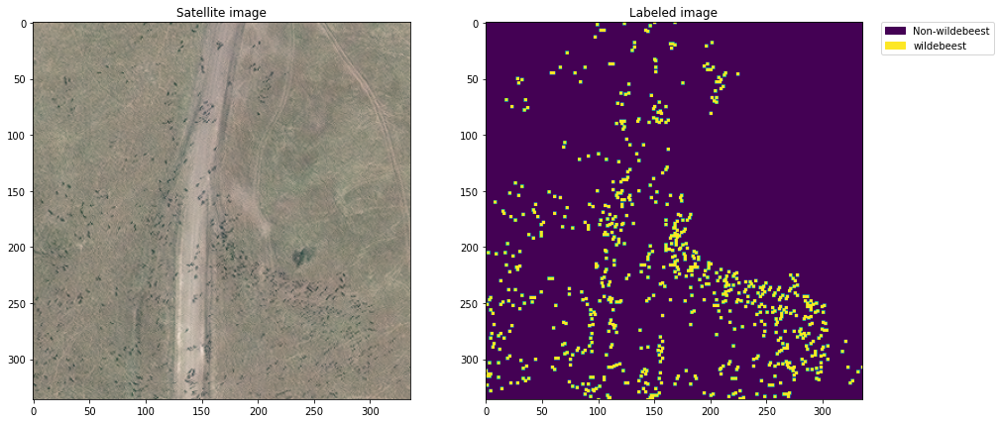

In [11]:
#visualize both images 
sample_image="004"
sample_label="004"

def visualize_data(data,data2):
    f, axarr = plt.subplots(1,2)
    data = data[:, :, 0:3]
    axarr[0].imshow(data)
    axarr[0].set_title("Satellite image")

    a=axarr[1]
    values = np.unique(data2.ravel())
    im = axarr[1].imshow(data2[:,:,0])
    a.set_title("Labeled image")
    colors = [im.cmap(im.norm(value)) for value in values] 
    #colors = [im.cmap(value) for value in values]
    data2 = ["Non-wildebeest", "wildebeest"]
    patches = [mpatches.Patch(color=colors[i], label=j) for i, j in zip(range(len(values)), data2)]
    plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0. )

visualize_data(image_list[sample_image],label_list[sample_label])

In [12]:
print(image_list.keys())

dict_keys(['000', '001', '002', '003', '004', '005', '006', '007', '008', '009', '010', '011', '012', '013', '014', '015', '016', '017', '018', '019', '020', '021', '022', '023', '024', '025', '026', '027', '028', '029', '030', '031', '032', '033', '034', '035'])


In [14]:
#convert data into smaller patches and keras usable formats

PATCHSIZE = 336
NBANDS = image_list["004"].shape[-1]

def gridwise_sample(imgarray, patchsize):
    """Extract sample patches of size patchsize x patchsize from an image (imgarray) in a gridwise manner.
    """
    nrows, ncols, nbands = imgarray.shape
    patchsamples = np.zeros(shape=(0, patchsize, patchsize, nbands),
                            dtype=imgarray.dtype)
    for i in range(int(nrows/patchsize)):
        for j in range(int(ncols/patchsize)):
            tocat = imgarray[i*patchsize:(i+1)*patchsize,
                             j*patchsize:(j+1)*patchsize, :]
            tocat = np.expand_dims(tocat, axis=0)
            patchsamples = np.concatenate((patchsamples, tocat),
                                          axis=0)
    return patchsamples

#Convert training dataset into patches
Xtrain = np.zeros(shape=(0, PATCHSIZE, PATCHSIZE, NBANDS), dtype=np.uint8)
Ytrain = np.zeros(shape=(0, PATCHSIZE, PATCHSIZE, 1), dtype=np.uint8)

for area in image_list.keys():
    X_toadd = gridwise_sample(image_list[area], PATCHSIZE)
    Y_toadd = gridwise_sample(label_list[area], PATCHSIZE)
    Xtrain = np.concatenate((Xtrain, X_toadd), axis=0)
    Ytrain = np.concatenate((Ytrain, Y_toadd), axis=0)

print("There are %i number of training patches" % (Xtrain.shape[0]))
#print("There are %i number of testing patches" % (Xtest.shape[0]))

There are 36 number of training patches


In [15]:
#Convert testing dataset into patches
Xtest = np.zeros(shape=(0, PATCHSIZE, PATCHSIZE, NBANDS), dtype=np.uint8)
Ytest = np.zeros(shape=(0, PATCHSIZE, PATCHSIZE, 1), dtype=np.uint8)
for area in test_image_list.keys():
    X_toadd = gridwise_sample(test_image_list[area], PATCHSIZE)
    Y_toadd = gridwise_sample(test_label_list[area], PATCHSIZE)
    Xtest = np.concatenate((Xtest, X_toadd), axis=0)
    Ytest = np.concatenate((Ytest, Y_toadd), axis=0)

In [16]:
#Check the percentage of wildebeest pixels with respect to non-wildebeest
wb_px=len(Ytrain[Ytrain==1])/(len(Ytrain[Ytrain==1])+len(Ytrain[Ytrain==0]))
nonwb_px=len(Ytrain[Ytrain==0])/(len(Ytrain[Ytrain==1])+len(Ytrain[Ytrain==0]))
print("Pixel percentage of Wildbeests = " + str(wb_px* 100)) #We can observe that the percentage of wildebeest pixels are really less (<3%)
print("Pixel percentage of non-Wildbeests = " + str(nonwb_px* 100)) 

Pixel percentage of Wildbeests = 2.049870874275636
Pixel percentage of non-Wildbeests = 97.95012912572436


In [17]:
#Visualize the Patches of Image
#PATCH_NO = 3
#visualize_data(Xtrain[PATCH_NO],Ytrain[PATCH_NO])

##Data augmentation

In [18]:
#!pip install git+https://github.com/aleju/imgaug

In [19]:
import imgaug.augmenters as iaa

In [20]:
#Define data augmentation functions: flip up and down; linear contrast; and rotate 90 degrees
seq_flipud = iaa.Sequential([
    iaa.Flipud(1),
])
seq_contrast = iaa.Sequential([
    iaa.LinearContrast(alpha=1.6, per_channel=True)                           
])
seq_fliplr = iaa.Sequential([
    iaa.Fliplr(1)
])
seq_rotate = iaa.Sequential([
    iaa.Affine(rotate=90)
])

In [21]:
#Define data augmentation function
#Given the limited number of training images (only 36), 
#all the augmented images using different augmentation are kept as training images.
#So 36 patches -> 36*4 = 144 patches
def augment_data(Xtrain, Ytrain):
  Xtrain_contrast = seq_contrast(images=Xtrain)
  Ytrain_contrast = Ytrain
  Xtrain_fliplr = seq_fliplr(images=Xtrain_contrast)
  Ytrain_fliplr = seq_fliplr(images=Ytrain_contrast)
  #Xtrain_flipud = seq_flipud(images=Xtrain_contrast)
  #Ytrain_flipud = seq_flipud(images=Ytrain_contrast)
  Xtrain_rotate = seq_rotate(images=Xtrain_contrast)
  Ytrain_rotate = seq_rotate(images=Ytrain_contrast)
  
  Xtrain = np.concatenate((Xtrain, Xtrain_fliplr, Xtrain_rotate, Xtrain_contrast), axis=0)
  Ytrain = np.concatenate((Ytrain, Ytrain_fliplr, Ytrain_rotate, Ytrain_contrast), axis=0)
  Xtrain = np.float32(Xtrain)
  Ytrain = np.float32(Ytrain)
  print("There are %i number of augmented training patches" % (Xtrain.shape[0]))
  return Xtrain, Ytrain

In [22]:
'''
Xtrain = np.concatenate((Xtrain, Xtrain_fliplr, Xtrain_flipud, Xtrain_contrast), axis=0)
Ytrain = np.concatenate((Ytrain, Ytrain_fliplr, Ytrain_flipud, Ytrain_contrast), axis=0)
print("There are %i number of training patches" % (Xtrain.shape[0]))
'''
Xtrain_full, Ytrain_full = augment_data(Xtrain, Ytrain)
print(Xtrain_full.shape)
print(Ytrain_full.shape)

There are 144 number of augmented training patches
(144, 336, 336, 4)
(144, 336, 336, 1)


In [23]:
#Augment test images using linear contrast
Xtest = np.float32(Xtest)
Ytest = np.float32(Ytest)
Xtest_contrast = seq_contrast(images=Xtest)
Ytest_contrast = Ytest

**`Convert the label data to categorical as one-hot encoding`**

In [ ]:
'''
def to_categorical_4d(y, nc):
    Y = np.zeros((y.shape[0],
                  y.shape[1],
                  y.shape[2],
                  nc),
                  dtype=np.int32)
    for h in range(y.shape[0]):
        for i in range(y.shape[1]):
            for j in range(y.shape[2]):
                if y[h, i, j, 0] != 0:
                    Y[h, i, j, y[h, i, j, 0]-1] = 1
                else:
                    continue
    return Y
# transform target arrays to one-hot encodings
Ytrain = to_categorical_4d(Ytrain, 2)
'''

# Model generation (U-Net) and training

##Define the model (U-Net)

In [37]:
#    Edited by Sizhuo Li
#    Author: Ankit Kariryaa, University of Bremen


import tensorflow.keras.backend as K
import numpy as np
import tensorflow as tf

#Tversky loss function, which assigns more weights to false positive/false negative by adjusting alpha and beta parameters
def tversky(y_true, y_pred, alpha=0.3, beta=0.7):
    """
    Function to calculate the Tversky loss for imbalanced data
    :param prediction: the logits
    :param ground_truth: the segmentation ground_truth
    :param alpha: weight of false positives
    :param beta: weight of false negatives
    :param weight_map:
    :return: the loss
    """
    '''

    EPSILON = 0.00001
    '''
    y_true_pos = K.flatten(y_true)
    y_pred_pos = K.flatten(y_pred)
    # TP
    true_pos = K.sum(y_true_pos * y_pred_pos)
    # FN
    false_neg = K.sum(y_true_pos * (1-y_pred_pos))
    # FP
    false_pos = K.sum((1-y_true_pos) * y_pred_pos)
    return 1 - (true_pos + K.epsilon())/(true_pos + alpha * false_neg + beta * false_pos + K.epsilon())

def accuracy(y_true, y_pred, threshold=0.5):
    """compute accuracy"""
    y_t = y_true[...,0]
    y_t = y_t[...,np.newaxis]
    y_pred = K.round(y_pred +0.5 - threshold)
    return K.equal(K.round(y_t), K.round(y_pred))
'''
def dice_coef(y_true, y_pred, smooth=0.0000001):
    """compute dice coef"""
    y_t = y_true[...,0]
    y_t = y_t[...,np.newaxis]
    intersection = K.sum(K.abs(y_t * y_pred), axis=-1)
    union = K.sum(y_t, axis=-1) + K.sum(y_pred, axis=-1)
    return K.mean((2. * intersection + smooth) / (union + smooth), axis=-1)

def dice_loss(y_true, y_pred):
    """compute dice loss"""
    y_t = y_true[...,0]
    y_t = y_t[...,np.newaxis]
    return 1 - dice_coef(y_t, y_pred)
'''
# K.round() returns the Element-wise rounding to the closest integer!!!
# so the threshold to determine a true positive is here!!!!!
def true_positives(y_true, y_pred, threshold=0.5):
    """compute true positive"""
    #y_t = y_true[...,0]
    #y_t = y_t[...,np.newaxis]
    y_pred = K.round(y_pred +0.5 - threshold)
    return K.round(y_true * y_pred)

def false_positives(y_true, y_pred, threshold=0.5):
    """compute false positive"""
    #y_t = y_true[...,0]
    #y_t = y_t[...,np.newaxis]
    y_pred = K.round(y_pred +0.5 - threshold)
    return K.round((1 - y_true) * y_pred)

def true_negatives(y_true, y_pred, threshold=0.5):
    """compute true negative"""
    #y_t = y_true[...,0]
    #y_t = y_t[...,np.newaxis]
    y_pred = K.round(y_pred +0.5 - threshold)
    return K.round((1 - y_true) * (1 - y_pred))

def false_negatives(y_true, y_pred, threshold=0.5):
    """compute false negative"""
    #y_t = y_true[...,0]
    #y_t = y_t[...,np.newaxis]
    y_pred = K.round(y_pred +0.5 - threshold)
    return K.round((y_true) * (1 - y_pred))
'''
def sensitivity(y_true, y_pred):
    """compute sensitivity (recall)"""
    #y_t = y_true[...,0]
    #y_t = y_t[...,np.newaxis]
    tp = true_positives(y_true, y_pred)
    fn = false_negatives(y_true, y_pred)
    return K.sum(tp) / (K.sum(tp) + K.sum(fn))

def specificity(y_true, y_pred):
    """compute specificity ()"""
    #y_t = y_true[...,0]
    #y_t = y_t[...,np.newaxis]
    tn = true_negatives(y_true, y_pred)
    fp = false_positives(y_true, y_pred)
    return K.sum(tn) / (K.sum(tn) + K.sum(fp))
'''
def recall_m(y_true, y_pred):
    #y_t = y_true[...,0]
    #y_t = y_t[...,np.newaxis]
    tp = true_positives(y_true, y_pred)
    fn = false_negatives(y_true, y_pred)
    recall = K.sum(tp) / (K.sum(tp) + K.sum(fn)+ K.epsilon())
    return recall

def precision_m(y_true, y_pred):
    #y_t = y_true[...,0]
    #y_t = y_t[...,np.newaxis]
    tp = true_positives(y_true, y_pred)
    fp = false_positives(y_true, y_pred)
    precision = K.sum(tp) / (K.sum(tp) + K.sum(fp)+ K.epsilon())
    return precision

def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))

In [38]:
#    Author: Ankit Kariryaa, University of Bremen

from tensorflow.keras.optimizers import Adam, Adadelta, Adagrad, Nadam

# Optimezers; https://keras.io/optimizers/
adaDelta = Adadelta(lr=1.0, rho=0.95, epsilon=None, decay=0.0)
adam = Adam(lr= 1.0e-03, decay= 0.0, beta_1= 0.9, beta_2= 0.999, epsilon= 1.0e-8)
nadam = Nadam(lr=0.002, beta_1=0.9, beta_2=0.999, epsilon=None, schedule_decay=0.004)
adagrad = Adagrad(lr=0.01, epsilon=None, decay=0.0)



In [39]:
#Model builder

NUMBER_BANDS = 4

def unet(pretrained_weights = None,input_size = (PATCHSIZE,PATCHSIZE,NUMBER_BANDS),regularizers = regularizers.l2(0.0001)):
    inputs = Input(input_size)
    #conv1 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(inputs)
    conv1 = Conv2D(64, 3, activation = 'relu', padding = 'same')(inputs)
    conv1 = Conv2D(64, 3, activation = 'relu', padding = 'same')(conv1)
    norm1 = BatchNormalization()(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(norm1)
    conv2 = Conv2D(128, 3, activation = 'relu', padding = 'same')(pool1)
    conv2 = Conv2D(128, 3, activation = 'relu', padding = 'same')(conv2)
    norm2 = BatchNormalization()(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(norm2)
    conv3 = Conv2D(256, 3, activation = 'relu', padding = 'same')(pool2)
    conv3 = Conv2D(256, 3, activation = 'relu', padding = 'same')(conv3)
    norm3 = BatchNormalization()(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(norm3)
    conv4 = Conv2D(512, 3, activation = 'relu', padding = 'same')(pool3)
    conv4 = Conv2D(512, 3, activation = 'relu', padding = 'same')(conv4)
    norm4 = BatchNormalization()(conv4)
    drop4 = Dropout(0.5)(norm4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(drop4)

    conv5 = Conv2D(1024, 3, activation = 'relu', padding = 'same')(pool4)
    conv5 = Conv2D(1024, 3, activation = 'relu', padding = 'same')(conv5)
    drop5 = Dropout(0.5)(conv5)

    up6 = Conv2D(512, 2, activation = 'relu', padding = 'same')(UpSampling2D(size = (2,2))(drop5))
    norm6 = BatchNormalization()(up6)
    merge6 = concatenate([drop4,norm6], axis = 3)
    conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same')(merge6)
    conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same')(conv6)

    up7 = Conv2D(256, 2, activation = 'relu', padding = 'same')(UpSampling2D(size = (2,2))(conv6))
    norm7 = BatchNormalization()(up7)
    merge7 = concatenate([norm3,norm7], axis = 3)
    conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same')(merge7)
    conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same')(conv7)

    up8 = Conv2D(128, 2, activation = 'relu', padding = 'same')(UpSampling2D(size = (2,2))(conv7))
    norm8 = BatchNormalization()(up8)
    merge8 = concatenate([norm2,norm8], axis = 3)
    conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same')(merge8)
    conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same')(conv8)

    up9 = Conv2D(64, 2, activation = 'relu', padding = 'same')(UpSampling2D(size = (2,2))(conv8))
    norm9 = BatchNormalization()(up9)
    merge9 = concatenate([norm1,norm9], axis = 3)
    conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same')(merge9)
    conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same')(conv9)
    conv9 = Conv2D(2, 3, activation = 'relu', padding = 'same')(conv9)
    conv10 = Conv2D(1, 1, activation = 'sigmoid', kernel_regularizer= regularizers)(conv9)
    # set the probablity threshold that determines the wildebeest existence

    model = Model(inputs = inputs, outputs = conv10)

    #model.compile(optimizer = Adam(lr = 1e-4), loss =BinaryFocalLoss(gamma=2.0, pos_weight=0.25), metrics = ['accuracy', recall_m, precision_m, f1_m])
    
    #Tree count code
    OPTIMIZER = adam
    LOSS = tversky 


    model.compile(optimizer=OPTIMIZER, loss=LOSS, metrics=[accuracy, recall_m, precision_m, f1_m])
    #model.summary()

    if(pretrained_weights):
    	model.load_weights(pretrained_weights)

    return model


#opt = tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.9)

#model.compile(optimizer='adam', loss=BinaryFocalLoss(gamma=5.0, pos_weight=0.5), metrics=['acc',f1_m,precision_m, recall_m]) # Use of'adam' optimiser

In [40]:
# Define callbacks for the early stopping of training, LearningRateScheduler and model checkpointing
from tensorflow.keras.callbacks import ModelCheckpoint, LearningRateScheduler, EarlyStopping, ReduceLROnPlateau, TensorBoard

OPTIMIZER_NAME = 'adam'
LOSS_NAME = 'tversky'
#model_path = os.path.join(model_path,'unet_{}_{}.hdf5'.format(OPTIMIZER_NAME,LOSS_NAME))
check_path = os.path.join('/content/drive/MyDrive/Colab/Wildebeest_UNet/tmp/checkpoint', 'weights.{epoch:02d}-{val_loss:.2f}.hdf5')

checkpoint = ModelCheckpoint(check_path, monitor='val_loss', verbose=1, 
                             save_best_only=True, mode='min', save_weights_only = True)

#reduceonplatea; It can be useful when using adam as optimizer
#Reduce learning rate when a metric has stopped improving (after some patience,reduce by a factor of 0.33, new_lr = lr * factor).
#cooldown: number of epochs to wait before resuming normal operation after lr has been reduced.
reduceLROnPlat = ReduceLROnPlateau(monitor='val_loss', factor=0.33,
                                   patience=20, verbose=1, mode='min',
                                   min_delta=0.0001, cooldown=4, min_lr=1e-16)

#early = EarlyStopping(monitor="val_loss", mode="min", verbose=2, patience=15)

log_dir = os.path.join('/content/drive/MyDrive/Colab/Wildebeest_UNet/tmp/logs','UNet_{}_{}'.format(OPTIMIZER_NAME,LOSS_NAME))
tensorboard = TensorBoard(log_dir=log_dir, histogram_freq=0, write_graph=True, write_grads=False, write_images=False, embeddings_freq=0, embeddings_layer_names=None, embeddings_metadata=None, embeddings_data=None, update_freq='epoch')

callbacks_list = [checkpoint, reduceLROnPlat, tensorboard] #reduceLROnPlat is not required with adaDelta

In [ ]:
#!pip install git+https://github.com/artemmavrin/focal-loss

In [ ]:
model.summary()

In [28]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Select the Runtime > "Change runtime type" menu to enable a GPU accelerator, ')
  print('and then re-execute this cell.')
else:
  print(gpu_info)


Mon Dec 21 11:36:59 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.45.01    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P0    24W / 300W |     10MiB / 16130MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

##K-fold cross validation

In [ ]:
import sklearn
from sklearn.model_selection import KFold

In [ ]:
num_folds = 10
# Define per-fold score containers
precision_per_fold = []
recall_per_fold = []
f1_per_fold = []
loss_per_fold = []
kfold = KFold(n_splits=num_folds, shuffle=True)

NUMBER_EPOCHS = 100 
BATCH_SIZE = 11 

In [ ]:
for train, test in kfold.split(Xtrain, Ytrain):
  print(train)
  print(test)

In [ ]:
# K-fold Cross Validation model evaluation
fold_no = 1
for train, test in kfold.split(Xtrain, Ytrain):

  xtrain, ytrain = augment_data(Xtrain[train], Ytrain[train])
  xtest = np.float32(Xtrain[test])
  ytest = np.float32(Ytrain[test])

  model = unet(pretrained_weights=None, input_size=(PATCHSIZE,PATCHSIZE,4))

  # Generate a print
  print('------------------------------------------------------------------------')
  print(f'Training for fold {fold_no} ...')

  hist = model.fit(x=xtrain,
                     y=ytrain,
                     epochs=NUMBER_EPOCHS,
                     batch_size = BATCH_SIZE,
                     validation_data=(xtest,ytest),
                     callbacks=callbacks_list,
                     verbose=2
                    )

  # Generate generalization metrics
  model.load_weights('/content/drive/MyDrive/Colab/Wildebeest_UNet/model/unet_AdaDelta_tversky.hdf5')
  scores = model.evaluate(xtest, ytest, verbose=0)
  print(f'Score for fold {fold_no}: {model.metrics_names[2]} of {scores[2]}; {model.metrics_names[3]} of {scores[3]}; {model.metrics_names[4]} of {scores[4]}')
  recall_per_fold.append(scores[2] * 100)
  precision_per_fold.append(scores[3] * 100)
  f1_per_fold.append(scores[4] * 100)
  loss_per_fold.append(scores[0])

  # Increase fold number
  fold_no = fold_no + 1




There are 156 number of augmented training patches
------------------------------------------------------------------------
Training for fold 1 ...
Epoch 1/100
Instructions for updating:
use `tf.profiler.experimental.stop` instead.

Epoch 00001: val_loss improved from inf to 0.98133, saving model to /content/drive/My Drive/Colab/Wildebeest_UNet/model/unet_AdaDelta_tversky.hdf5
15/15 - 13s - loss: 0.9652 - dice_coef: 0.0158 - dice_loss: 0.9842 - accuracy: 0.4074 - recall_m: 0.9652 - precision_m: 0.0319 - f1_m: 0.0616 - val_loss: 0.9813 - val_dice_coef: 0.0087 - val_dice_loss: 0.9913 - val_accuracy: 0.9867 - val_recall_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_f1_m: 0.0000e+00
Epoch 2/100

Epoch 00002: val_loss did not improve from 0.98133
15/15 - 10s - loss: 0.9583 - dice_coef: 0.0169 - dice_loss: 0.9831 - accuracy: 0.7358 - recall_m: 0.9855 - precision_m: 0.0649 - f1_m: 0.1209 - val_loss: 0.9813 - val_dice_coef: 0.0086 - val_dice_loss: 0.9914 - val_accuracy: 0.9862 - val_recall

NameError: ignored

In [ ]:
# == Provide average scores ==
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(loss_per_fold)):
  print('------------------------------------------------------------------------')
  print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Recall: {recall_per_fold[i]}% - Precision: {precision_per_fold[i]}% - F1: {f1_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Precision: {np.mean(precision_per_fold)} (+- {np.std(precision_per_fold)})%')
print(f'> Recall: {np.mean(recall_per_fold)} (+- {np.std(recall_per_fold)})%')
print(f'> F1-score: {np.mean(f1_per_fold)} (+- {np.std(f1_per_fold)})%')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')

SyntaxError: ignored

##Train the model with full dataset

In [41]:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/Colab/Wildebeest_UNet/tmp/logs/UNet_adam_tversky

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 420), started 2:24:35 ago. (Use '!kill 420' to kill it.)

<IPython.core.display.Javascript object>

In [44]:
NUMBER_EPOCHS = 200 
BATCH_SIZE = 12 
model = unet(pretrained_weights=None, input_size=(PATCHSIZE,PATCHSIZE,4))
hist = model.fit(x=Xtrain_full,
                     y=Ytrain_full,
                     epochs=NUMBER_EPOCHS,
                     batch_size = BATCH_SIZE,
                     validation_data=(Xtest,Ytest),
                     callbacks=callbacks_list,
                     verbose=2
                    )

Epoch 1/200
12/12 - 8s - loss: 0.7318 - accuracy: 0.8647 - recall_m: 0.5685 - precision_m: 0.3592 - f1_m: 0.3026 - val_loss: 1.0002 - val_accuracy: 0.9919 - val_recall_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_f1_m: 0.0000e+00

Epoch 00001: val_loss did not improve from 1.00002
Epoch 2/200
12/12 - 5s - loss: 0.4400 - accuracy: 0.9827 - recall_m: 0.5044 - precision_m: 0.6091 - f1_m: 0.5408 - val_loss: 1.0002 - val_accuracy: 0.9919 - val_recall_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_f1_m: 0.0000e+00

Epoch 00002: val_loss did not improve from 1.00002
Epoch 3/200
12/12 - 5s - loss: 0.4142 - accuracy: 0.9838 - recall_m: 0.5188 - precision_m: 0.6483 - f1_m: 0.5604 - val_loss: 1.0002 - val_accuracy: 0.9919 - val_recall_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_f1_m: 0.0000e+00

Epoch 00003: val_loss did not improve from 1.00002
Epoch 4/200
12/12 - 5s - loss: 0.3930 - accuracy: 0.9845 - recall_m: 0.5554 - precision_m: 0.6464 - f1_m: 0.5895 - val_loss: 0.9993 - val_a

### Visualisation of the output curve and saving as weights

Visualize Learning Curve

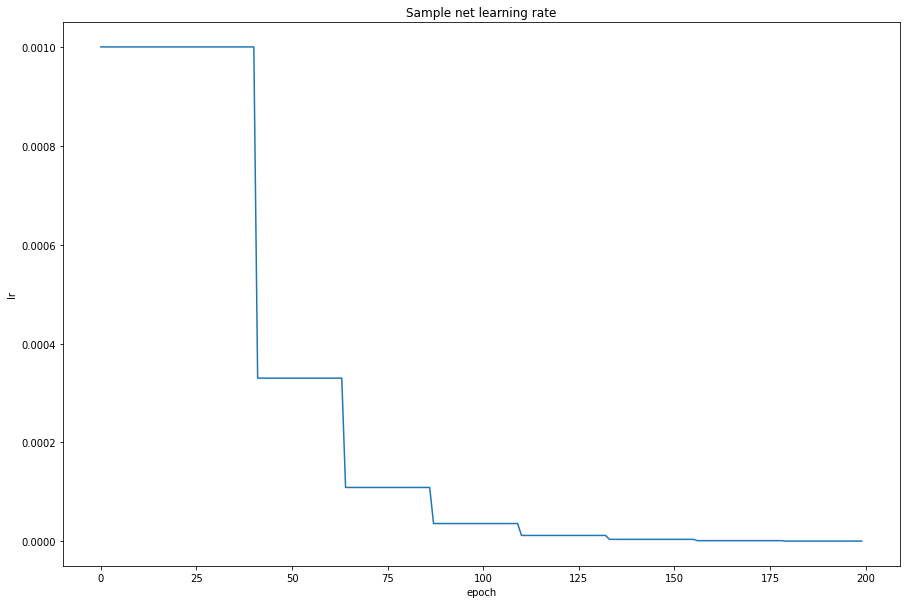

In [45]:
plt.plot(hist.history["lr"])
plt.title("Sample net learning rate")
plt.ylabel("lr")
plt.xlabel("epoch")
plt.show()

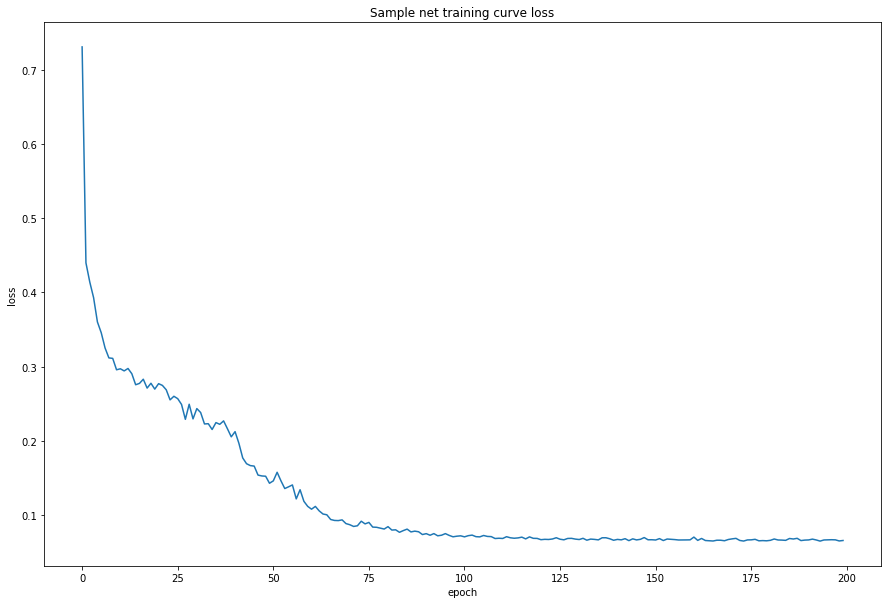

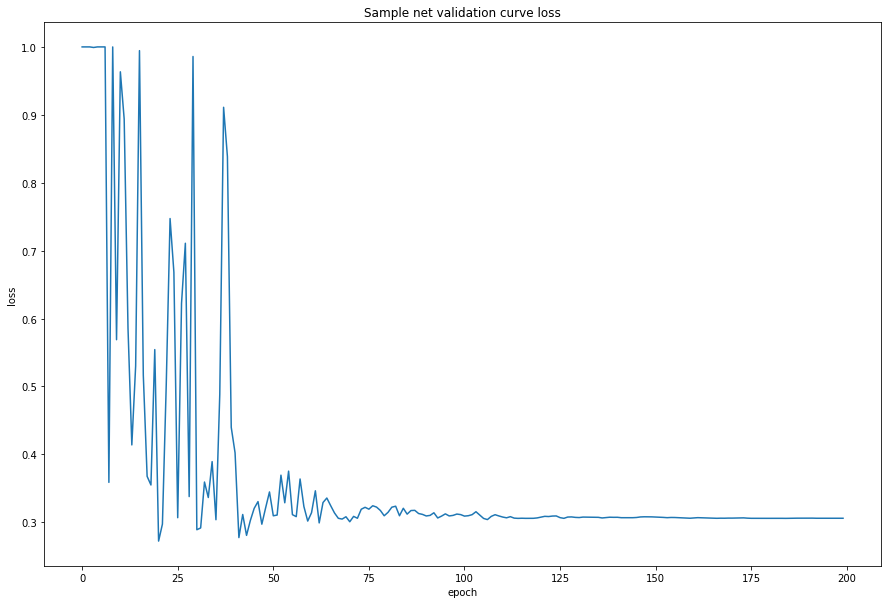

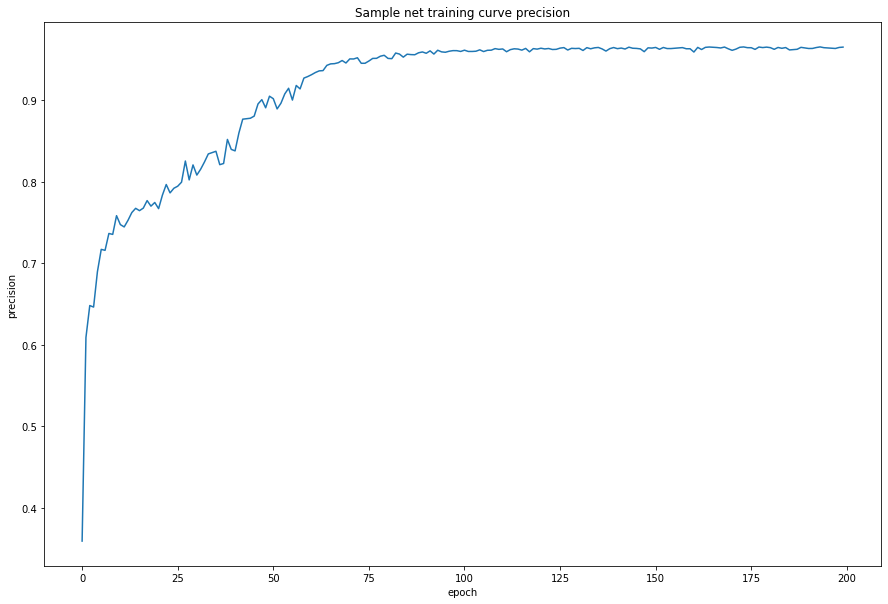

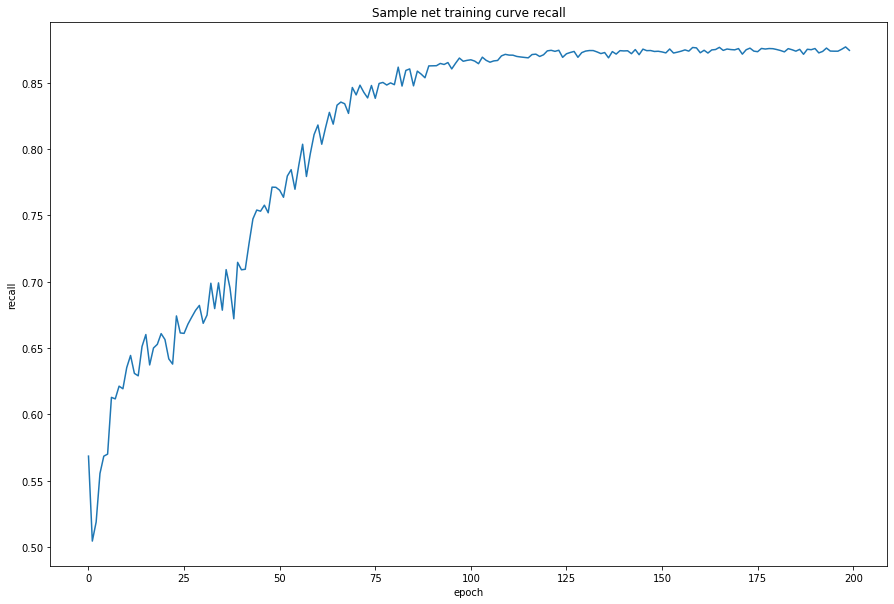

In [47]:
# plot learning curve
plt.plot(hist.history["loss"])
plt.title("Sample net training curve loss")
plt.ylabel("loss")
plt.xlabel("epoch")
plt.show()
plt.plot(hist.history["val_loss"])
plt.title("Sample net validation curve loss")
plt.ylabel("loss")
plt.xlabel("epoch")
plt.show()
plt.plot(np.array(hist.history["precision_m"]))
plt.title("Sample net training curve precision")
plt.ylabel("precision")
plt.xlabel("epoch")
plt.show()
plt.plot(np.array(hist.history["recall_m"]))
plt.title("Sample net training curve recall")
plt.ylabel("recall")
plt.xlabel("epoch")
plt.show()

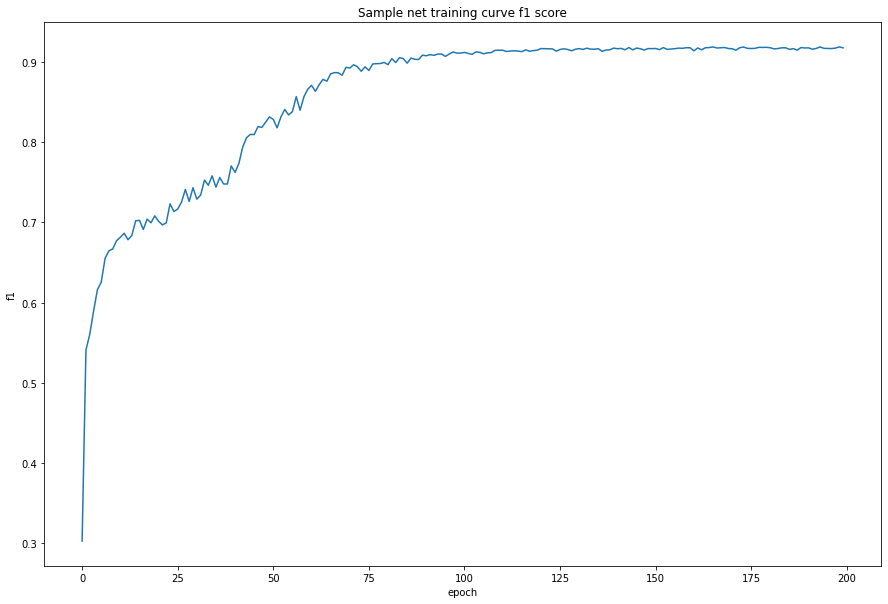

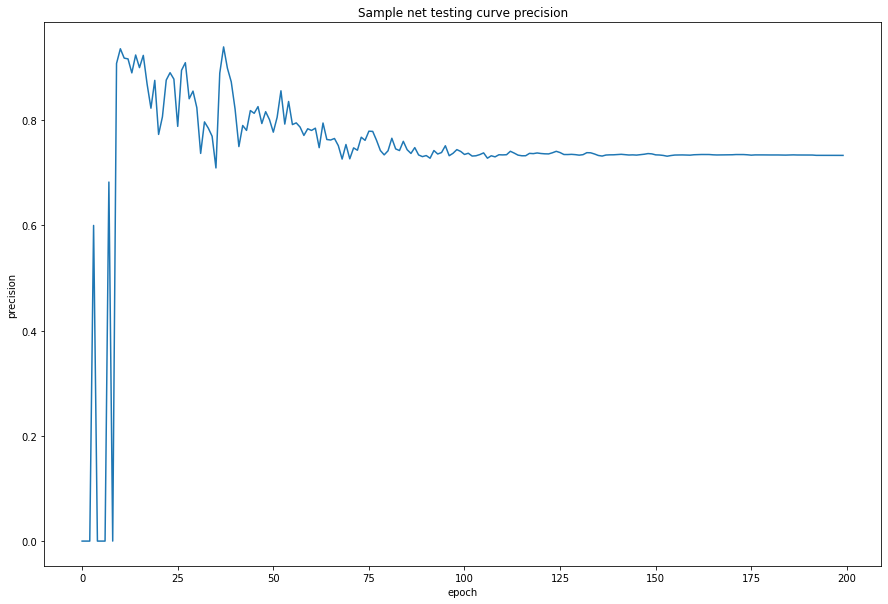

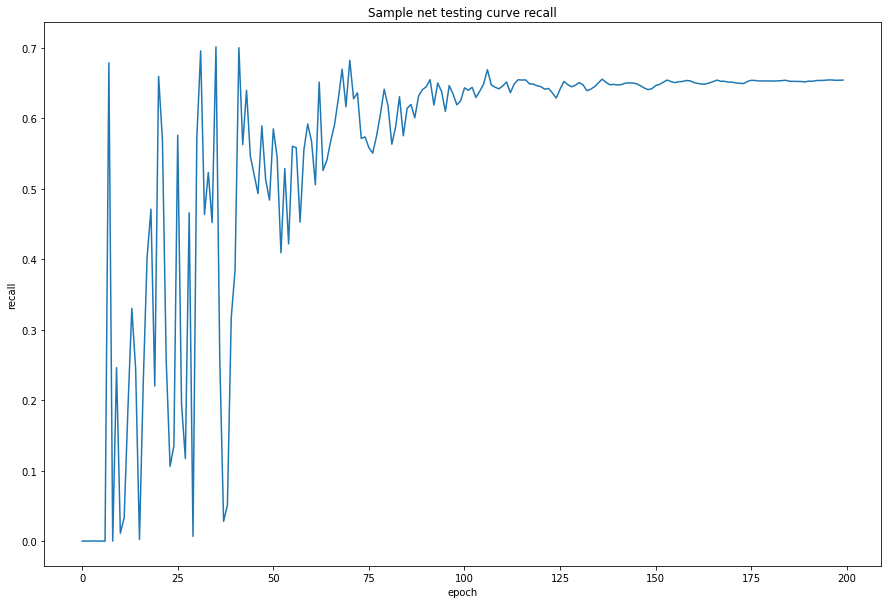

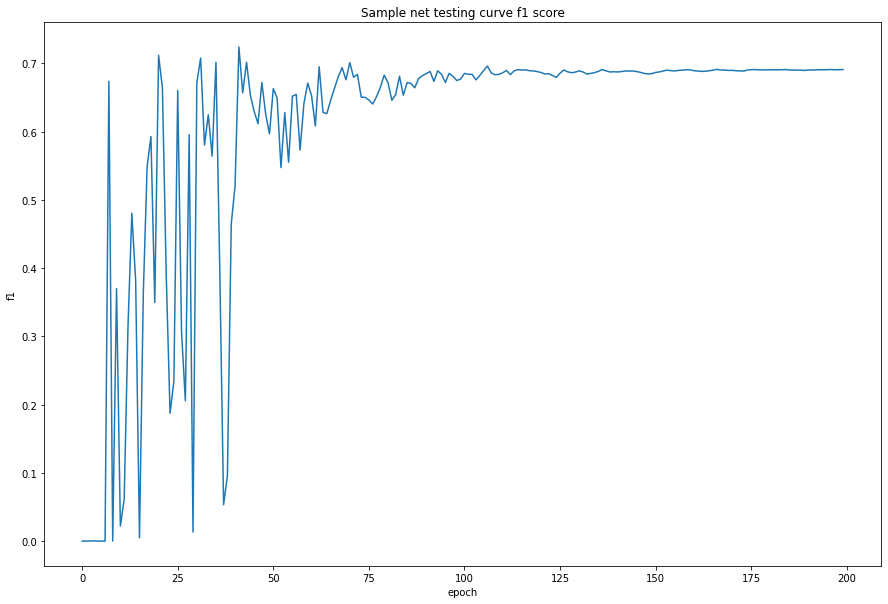

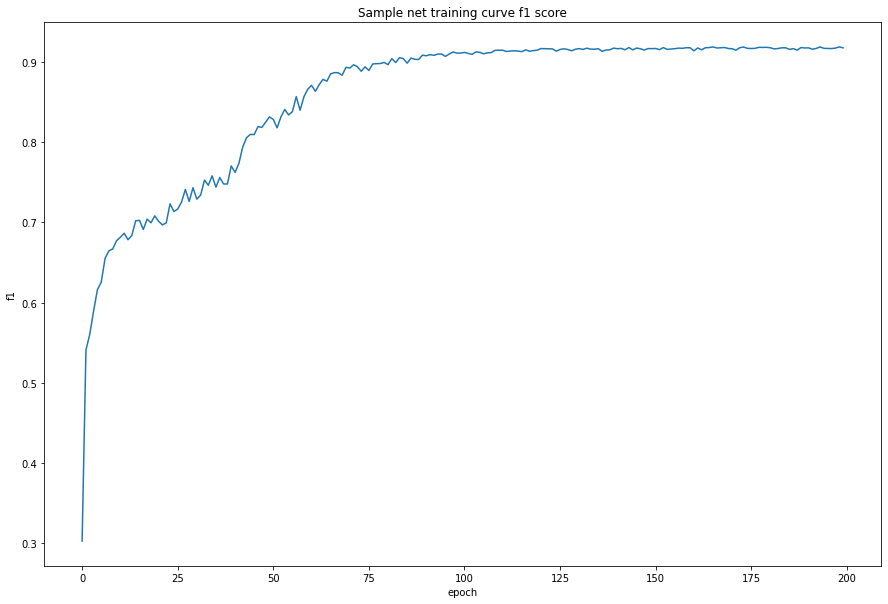

In [48]:
plt.plot(np.array(hist.history["f1_m"]))
plt.title("Sample net training curve f1 score")
plt.ylabel("f1")
plt.xlabel("epoch")
plt.show()
plt.plot(np.array(hist.history["val_precision_m"]))
plt.title("Sample net testing curve precision")
plt.ylabel("precision")
plt.xlabel("epoch")
plt.show()
plt.plot(np.array(hist.history["val_recall_m"]))
plt.title("Sample net testing curve recall")
plt.ylabel("recall")
plt.xlabel("epoch")
plt.show()
plt.plot(np.array(hist.history["val_f1_m"]))
plt.title("Sample net testing curve f1 score")
plt.ylabel("f1")
plt.xlabel("epoch")
plt.show()
plt.plot(np.array(hist.history["f1_m"]))
plt.title("Sample net training curve f1 score")
plt.ylabel("f1")
plt.xlabel("epoch")
plt.show()

Save output

In [ ]:
# save the trained network
import imp, h5py
imp.reload(h5py)
model_fname = os.path.join("/content/drive/My Drive/Colab/Wildebeest_UNet/weights", 
                           'wildebeest_{}_{}_{}.hdf5'.format(OPTIMIZER_NAME,LOSS_NAME,NUMBER_EPOCHS))
model.save(model_fname)

### Testing phase 

In [46]:
#model = unet(pretrained_weights=None, input_size=(PATCHSIZE,PATCHSIZE,4))
model.load_weights("/content/drive/MyDrive/Colab/Wildebeest_UNet/tmp/checkpoint/weights.21-0.27.hdf5")
scores1 = model.evaluate(Xtest, Ytest, verbose=0)
print(scores1)
scores2 = model.evaluate(Xtest_contrast, Ytest_contrast, verbose=0)
print(scores2)

[0.276748925447464, 0.9955522418022156, 0.6473088264465332, 0.764639675617218, 0.7010992169380188]
[0.40719619393348694, 0.9942569732666016, 0.3438977003097534, 0.8587374091148376, 0.4911178946495056]


In [ ]:
model.load_weights("/content/drive/MyDrive/Colab/Wildebeest_UNet/tmp/checkpoint_subTrain30Test_adam_lr0.0001/weights.137-0.30.hdf5")
scores3 = model.evaluate(Xtest, Ytest, verbose=0)
print(scores3)
scores4 = model.evaluate(Xtest_contrast, Ytest_contrast, verbose=0)
print(scores4)

[0.30007967352867126, 0.9665835499763489, 0.03341645002365112, 0.9956511855125427, 0.7984464764595032, 0.7025145292282104, 0.7474147081375122]
[0.3195438086986542, 0.9667974710464478, 0.03320253640413284, 0.9954125881195068, 0.5726743340492249, 0.801374077796936, 0.6679914593696594]


In [ ]:
model.load_weights("/content/drive/MyDrive/Colab/Wildebeest_UNet/tmp/checkpoint/weights.101-0.43.hdf5")
scores5 = model.evaluate(Xtest, Ytest, verbose=0)
print(scores5)
scores6 = model.evaluate(Xtest_contrast, Ytest_contrast, verbose=0)
print(scores6)

In [ ]:
print(scores2[4])

In [ ]:
def visualize_prediction(data,mask,predict):
    f, axarr = plt.subplots(1,3)
    data = data[:, :, 0:3] 
    axarr[0].imshow(data)
    axarr[0].set_title("Satellite image")

    a=axarr[1]
    values = np.unique(mask.ravel())
    im = axarr[1].imshow(mask[:,:,0])
    a.set_title("Ground truth labeled image")
    colors = [im.cmap(im.norm(value)) for value in values]

    b=axarr[2]
    values = np.unique(predict.ravel())
    im = axarr[2].imshow(predict[:,:,0])
    b.set_title("Predicted labeled image")
    colors = [im.cmap(im.norm(value)) for value in values]

    mask = ["Non-wildebeest", "wildebeest"]
    patches = [mpatches.Patch(color=colors[i], label=j) for i, j in zip(range(len(values)), mask)]
    plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0. )


(336, 336, 1)
1576
TP:  tf.Tensor(1349.0, shape=(), dtype=float32)
FP:  tf.Tensor(582.0, shape=(), dtype=float32)
TN:  tf.Tensor(110738.0, shape=(), dtype=float32)
FN:  tf.Tensor(227.0, shape=(), dtype=float32)
sensitivity: : tf.Tensor(0.8559645, shape=(), dtype=float32)
specificity:  tf.Tensor(0.99477184, shape=(), dtype=float32)
precision_m:  tf.Tensor(0.6986018, shape=(), dtype=float32)
recall_m:  tf.Tensor(0.8559645, shape=(), dtype=float32)
f1_m:  tf.Tensor(0.76931846, shape=(), dtype=float32)


ValueError: ignored

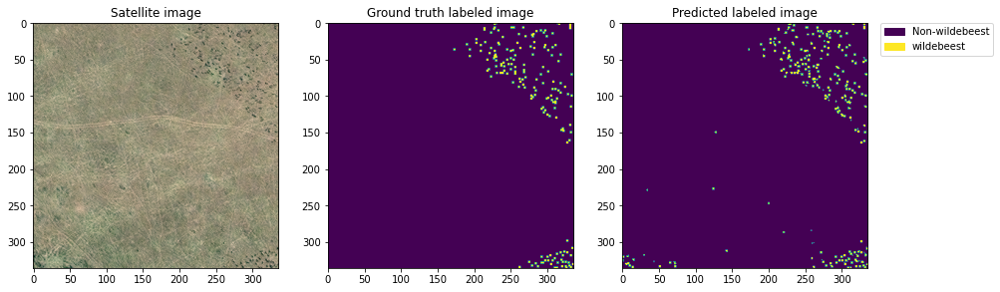

In [ ]:
Xpred = np.expand_dims(Xtest[4], axis=0)
#print(shape(Xpred))
prediction = model.predict(Xpred)
# Print one batch on the training/test data!
#test_images, real_label = next(test_generator)
#5 images per row: pan, ndvi, label, weight, prediction
#prediction = model.predict(test_images, steps=1)
prediction[prediction>0.5]=1.0
prediction[prediction<=0.5]=0.0
#print(shape(prediction))
print(shape(prediction[0]))
test = Ytest[4]
print(len(test[test==1]))
print("TP: ", K.sum(true_positives(Ytest[4], prediction[0])))
print("FP: ", K.sum(false_positives(Ytest[4], prediction[0])))
print("TN: ", K.sum(true_negatives(Ytest[4], prediction[0])))
print("FN: ", K.sum(false_negatives(Ytest[4], prediction[0])))
print("sensitivity: :", K.sum(sensitivity(test, prediction[0])))
print("specificity: " ,K.sum(specificity(test, prediction[0])))
print("precision_m: ",K.sum(precision_m(test, prediction[0])))
print("recall_m: " ,K.sum(recall_m(test, prediction[0])))
print("f1_m: " ,K.sum(f1_m(test, prediction[0])))
visualize_prediction(Xtest[4].astype('uint8'),Ytest[4], prediction[0])


(336, 336, 1)
1576
TP:  tf.Tensor(975.0, shape=(), dtype=float32)
FP:  tf.Tensor(201.0, shape=(), dtype=float32)
TN:  tf.Tensor(111119.0, shape=(), dtype=float32)
FN:  tf.Tensor(601.0, shape=(), dtype=float32)
sensitivity: : tf.Tensor(0.61865485, shape=(), dtype=float32)
specificity:  tf.Tensor(0.9981944, shape=(), dtype=float32)
precision_m:  tf.Tensor(0.82908165, shape=(), dtype=float32)
recall_m:  tf.Tensor(0.61865485, shape=(), dtype=float32)
f1_m:  tf.Tensor(0.70857555, shape=(), dtype=float32)


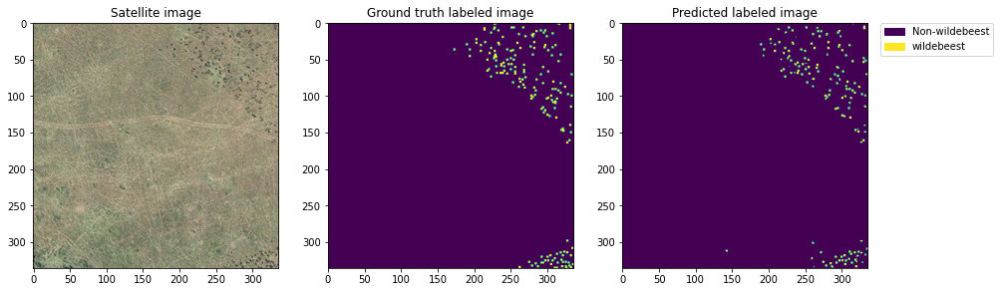

In [ ]:
from tensorflow.keras.models import load_model
OPTIMIZER = adaDelta 
LOSS = tversky
model2 = load_model("/content/drive/MyDrive/Colab/Wildebeest_UNet/model/unet_AdaDelta_tversky1.hdf5", custom_objects={'tversky': tversky, 'dice_coef': dice_coef, 'dice_loss':dice_loss, 'accuracy':accuracy , 'specificity': specificity, 'sensitivity':sensitivity}, compile=False)
model2.compile(optimizer=OPTIMIZER, loss=LOSS, metrics=[dice_coef, dice_loss, specificity, sensitivity,accuracy, recall_m, precision_m, f1_m])

Xpred = np.expand_dims(Xtest[4], axis=0)
#print(shape(Xpred))
prediction = model2.predict(Xpred)
# Print one batch on the training/test data!
#test_images, real_label = next(test_generator)
#5 images per row: pan, ndvi, label, weight, prediction
#prediction = model.predict(test_images, steps=1)
prediction[prediction>0.5]=1.0
prediction[prediction<=0.5]=0.0
#print(shape(prediction))
print(shape(prediction[0]))
test = Ytest[4]
print(len(test[test==1]))
print("TP: ", K.sum(true_positives(Ytest[4], prediction[0])))
print("FP: ", K.sum(false_positives(Ytest[4], prediction[0])))
print("TN: ", K.sum(true_negatives(Ytest[4], prediction[0])))
print("FN: ", K.sum(false_negatives(Ytest[4], prediction[0])))
print("sensitivity: :", K.sum(sensitivity(test, prediction[0])))
print("specificity: " ,K.sum(specificity(test, prediction[0])))
print("precision_m: ",K.sum(precision_m(test, prediction[0])))
print("recall_m: " ,K.sum(recall_m(test, prediction[0])))
print("f1_m: " ,K.sum(f1_m(test, prediction[0])))
visualize_prediction(Xtest[4].astype('uint8'),Ytest[4], prediction[0])

In [ ]:
#model2 = tf.keras.models.load_model("/content/drive/MyDrive/Colab/Wildebeest_UNet/model/unet_AdaDelta_tversky1.hdf5")
model.load_weights("/content/drive/MyDrive/Colab/Wildebeest_UNet/tmp/checkpoint/weights.102-0.34.hdf5")
#Xpred = np.expand_dims(Xtest[4], axis=0)
#print(shape(Xpred))
predictions = model.predict(Xtest)
# Print one batch on the training/test data!
#test_images, real_label = next(test_generator)
#5 images per row: pan, ndvi, label, weight, prediction
#prediction = model.predict(test_images, steps=1)
predictions[predictions>0.5]=1.0
predictions[predictions<=0.5]=0.0
#print(shape(prediction))
print(shape(predictions))

print("TP: ", K.sum(true_positives(Ytest, predictions)))
print("FP: ", K.sum(false_positives(Ytest, predictions)))
print("TN: ", K.sum(true_negatives(Ytest, predictions)))
print("FN: ", K.sum(false_negatives(Ytest, predictions)))
print("sensitivity: :", K.sum(sensitivity(Ytest, predictions)))
print("specificity: " ,K.sum(specificity(Ytest, predictions)))
print("precision_m: ",K.sum(precision_m(Ytest, predictions)))
print("recall_m: " ,K.sum(recall_m(Ytest, predictions)))
print("f1_m: " ,K.sum(f1_m(Ytest, predictions)))

(8, 336, 336, 1)
TP:  tf.Tensor(5289.0, shape=(), dtype=float32)
FP:  tf.Tensor(2368.0, shape=(), dtype=float32)
TN:  tf.Tensor(892315.0, shape=(), dtype=float32)
FN:  tf.Tensor(3196.0, shape=(), dtype=float32)
sensitivity: : tf.Tensor(0.6233353, shape=(), dtype=float32)
specificity:  tf.Tensor(0.99735326, shape=(), dtype=float32)
precision_m:  tf.Tensor(0.6907405, shape=(), dtype=float32)
recall_m:  tf.Tensor(0.6233353, shape=(), dtype=float32)
f1_m:  tf.Tensor(0.6553091, shape=(), dtype=float32)


In [ ]:
OPTIMIZER = adaDelta
LOSS = tversky 
model = load_model("/content/drive/MyDrive/Colab/Wildebeest_UNet/model/unet_AdaDelta_tversky1.hdf5", custom_objects={'tversky': tversky, 'dice_coef': dice_coef, 'dice_loss':dice_loss, 'accuracy':accuracy , 'specificity': specificity, 'sensitivity':sensitivity}, compile=False)
model.compile(optimizer=OPTIMIZER, loss=LOSS, metrics=[dice_coef, dice_loss, specificity, sensitivity,accuracy, recall_m, precision_m, f1_m])
predictions = model.predict(test_list)
# Print one batch on the training/test data!
#test_images, real_label = next(test_generator)
#5 images per row: pan, ndvi, label, weight, prediction
#prediction = model.predict(test_images, steps=1)
predictions[predictions>0.5]=1.0
predictions[predictions<=0.5]=0.0
#print(shape(prediction))
print(shape(predictions))

(120, 336, 336, 1)


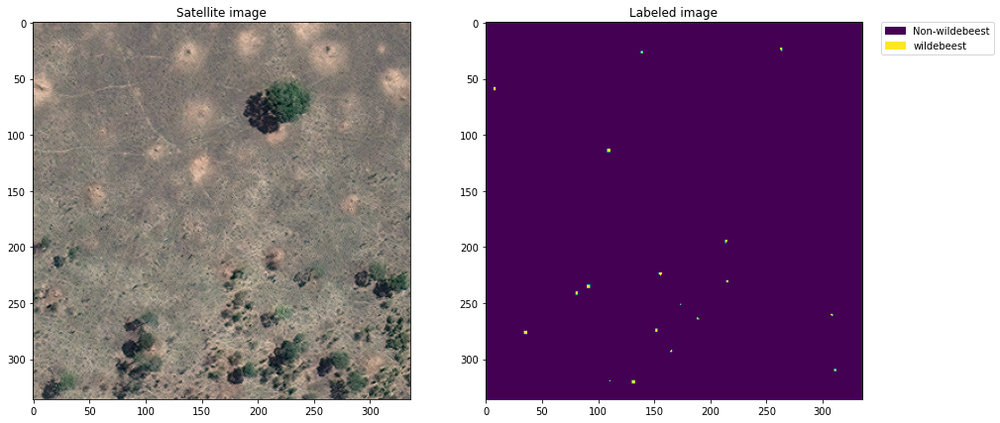

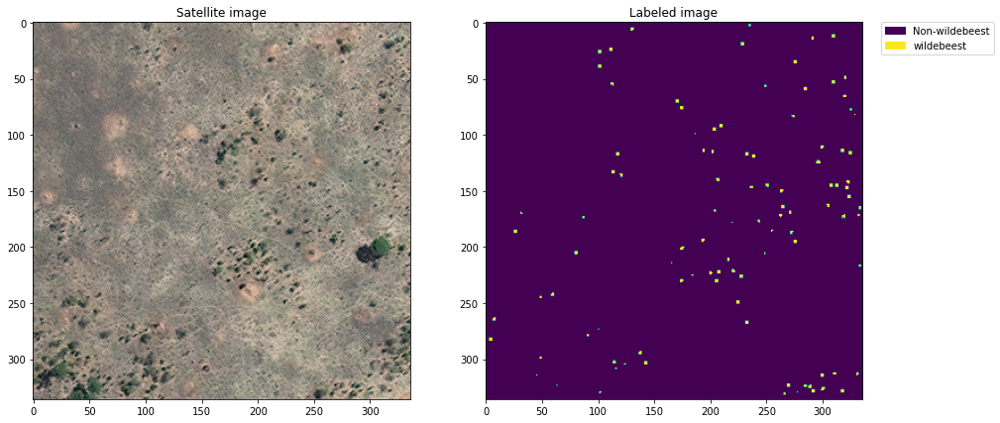

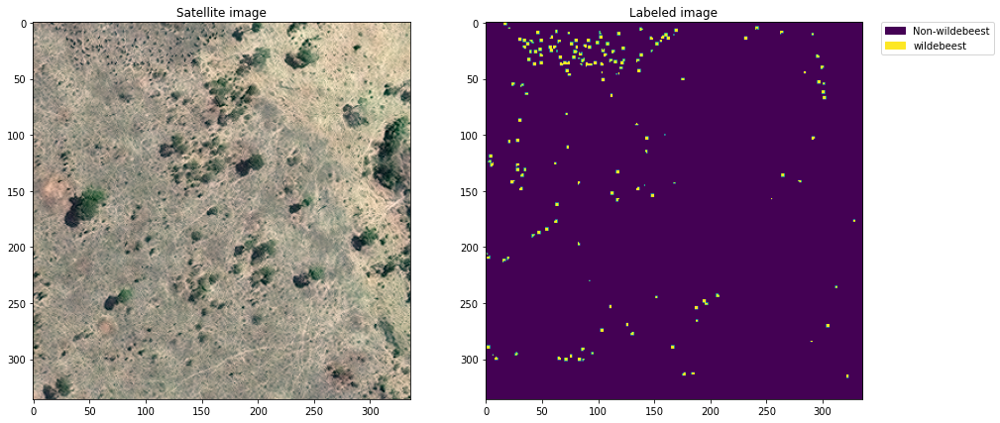

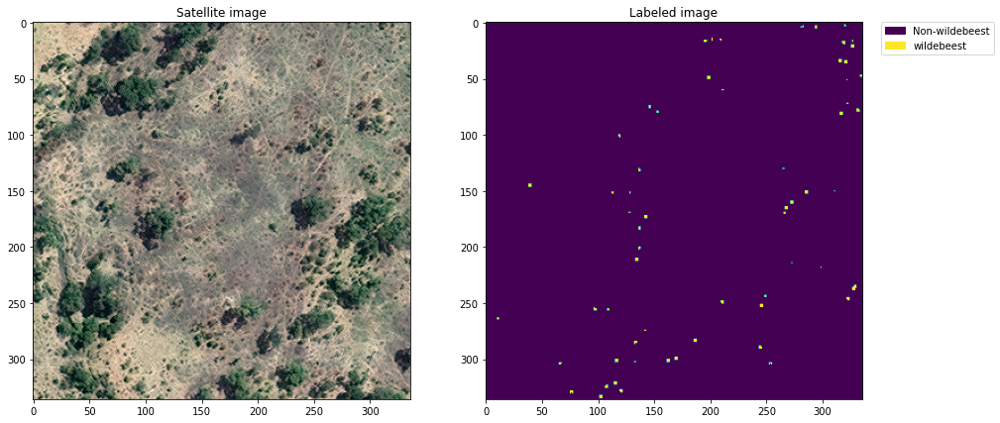

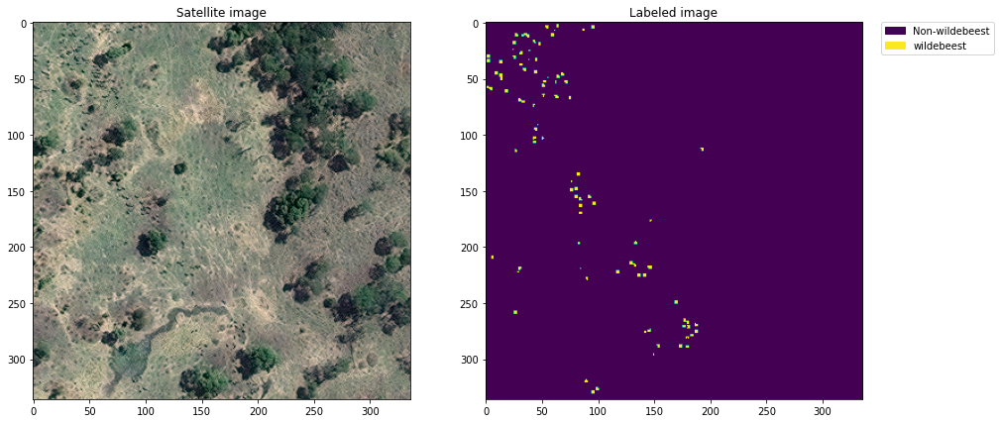

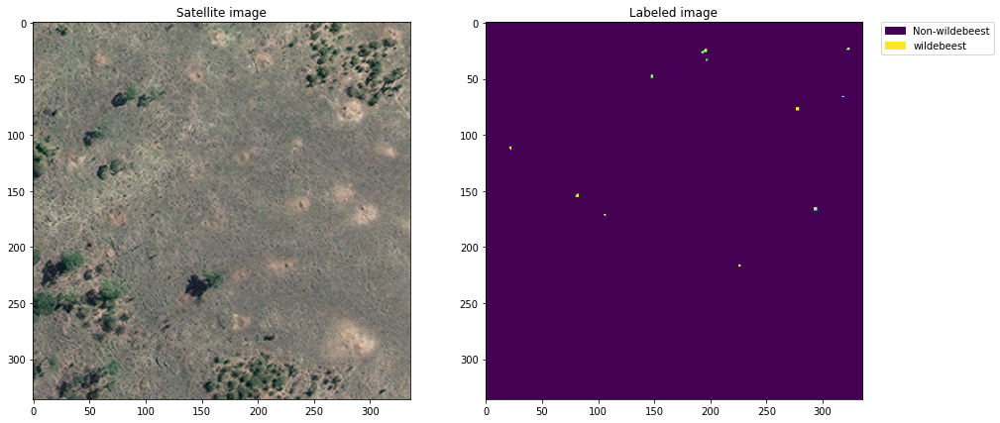

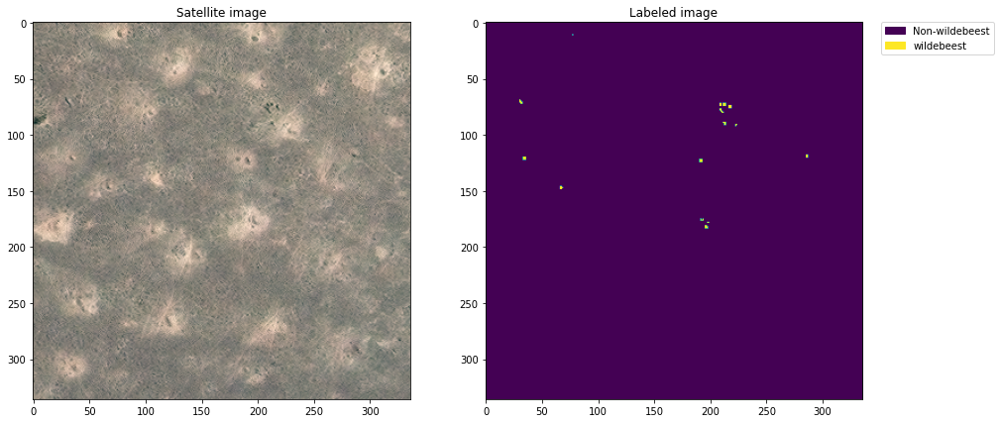

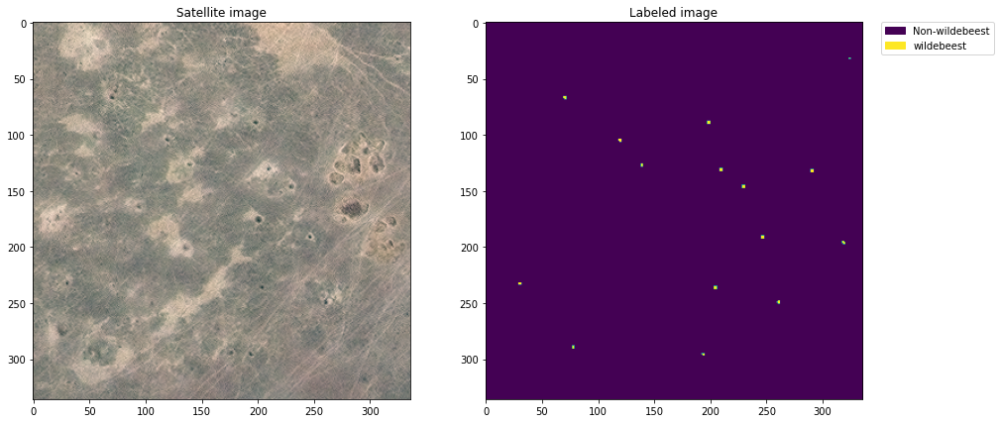

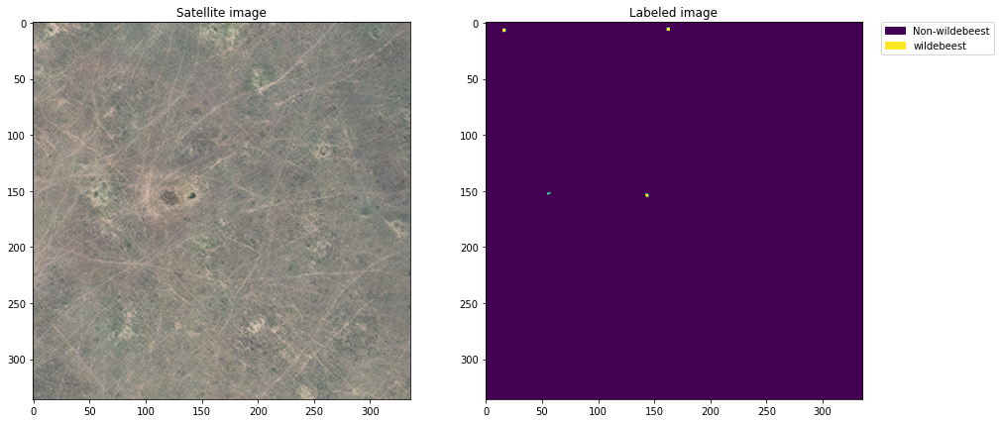

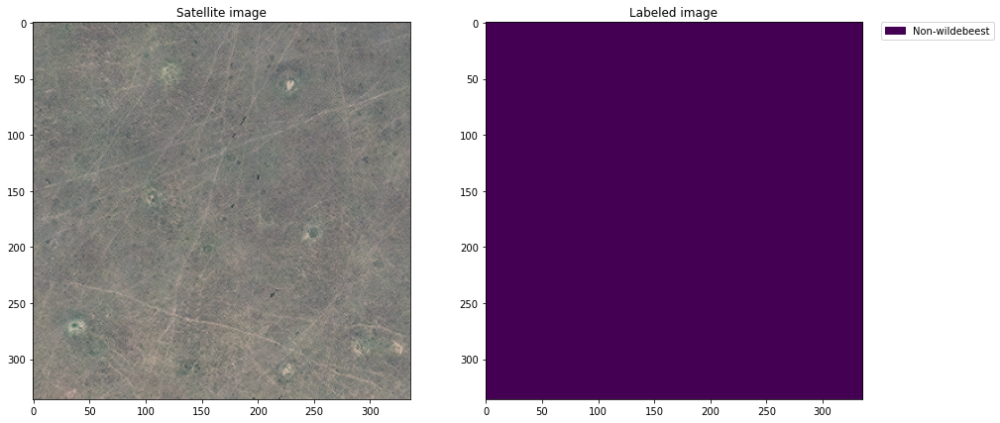

In [ ]:
for i in range(50,60):
  visualize_data(test_list[i].astype('uint8'),predictions[i,:,:,:])

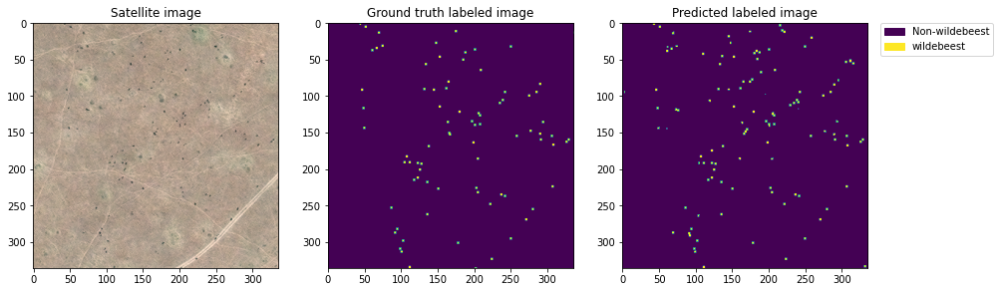

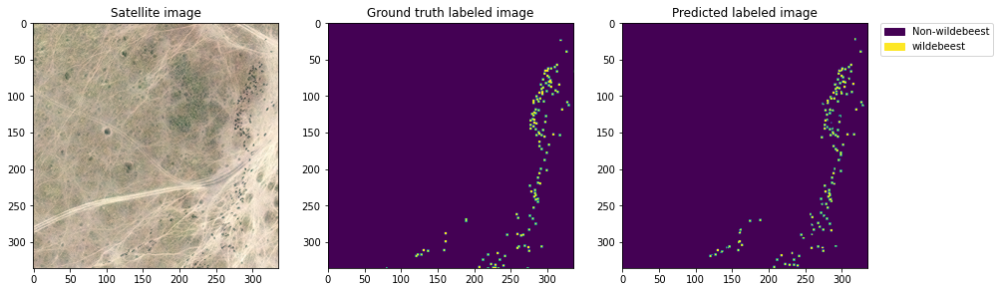

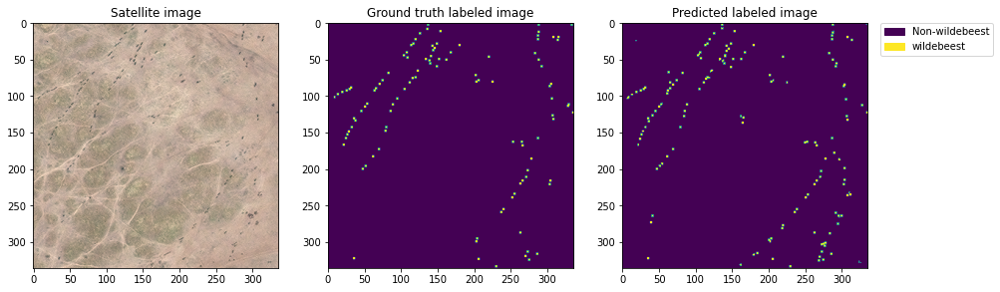

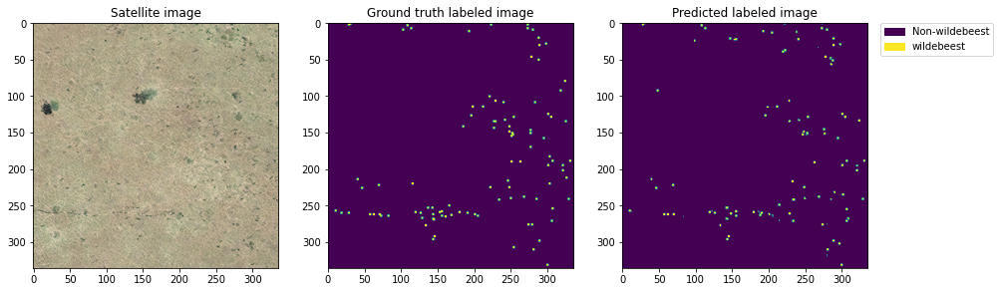

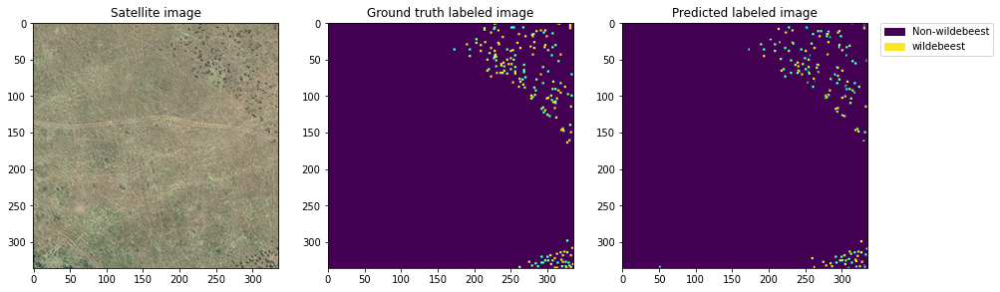

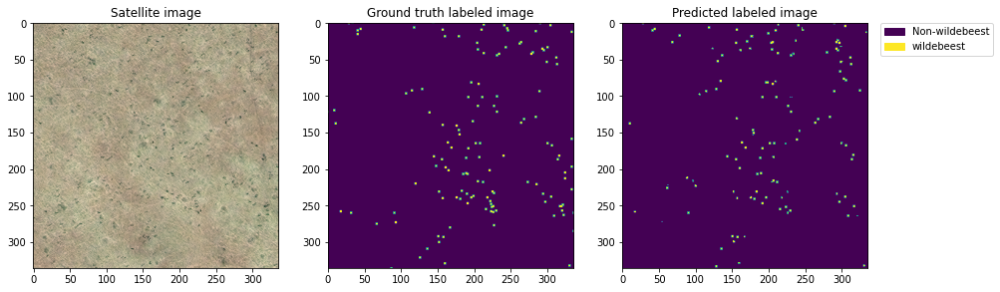

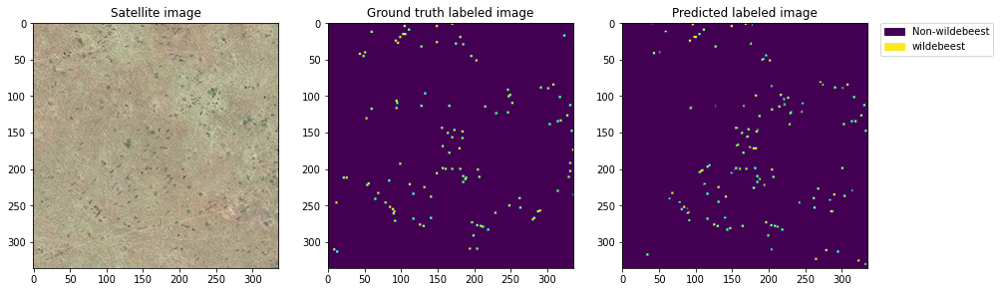

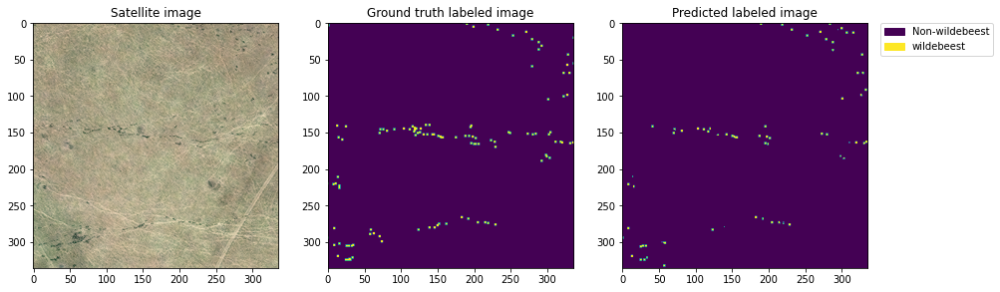

In [ ]:
for i in range(shape(Xtest)[0]):
  visualize_prediction(Xtest[i].astype('uint8'),Ytest[i],predictions[i,:,:,:])
